# Homogenous 1D Elastic Wave Equation 

In order to explote finite volume solvers we seek to investigate the 1-D elastic wave equation propogating through a homogenous medium. The source free elastic wave equation can be written a coupled sytems of equation 
$$
\begin{equation}
\begin{gathered}
    \frac{\partial}{\partial t} \sigma - \mu \frac{\partial}{\partial x} v = 0  \\
     \frac{\partial}{\partial t} v - \frac{1}{\rho} \frac{\partial}{\partial x} \sigma = 0 
\end{gathered}
\end{equation}
$$
where $\sigma = \sigma_{xy}(x,t)$ is the shear stress component of the stress tensor, $v = v_y(x,t)$ is the transerve velocity, $\rho$ is the density and $\mu$ is the bulk modulus. In matrix vector notation the equation becomes 
$$
\begin{gather*}
    \partial_t \begin{bmatrix} \sigma \\ v \end{bmatrix} + \begin{bmatrix} 0 & -\mu \\ -1/\rho & 0 \end{bmatrix} \partial_x \begin{bmatrix} \sigma \\ v \end{bmatrix} = 0
\end{gather*}
$$
which simplifies to 
$$
    \partial_t Q + A \partial_x Q = 0. 
$$
Our elastic wave eqaution above is analgous to the 1-D advection equation except our equations above are a couple system of equations. In order to make use  of the well documented numerical methods for the 1-D advection equation we must decouple this system. We seek to show that the equation is hyperbolic by demonstarting that $A$ is diagonalizable with real eigenvalues. We are looking for the eigenvalue decomposition of $A$ such that 
$$
\begin{equation*}
    A = X \Lambda X^{-1}\\
\end{equation*}
$$
By subbing in the the eigendecompostion of $A$ into our matrix vector form of our equation and multiplying both sides of the equation by $X^{-1}$ we get 
$$
\begin{equation*}
   X^{-1} \partial_t Q +X^{-1} X \Lambda X^{-1} \partial_x Q = 0. 
\end{equation*}
$$
where the $X^{-1}Q = W$ the solution vector. Simplying the equation 
$$
\begin{equation*}
   \partial_t W + \Lambda \partial_x W = 0. 
\end{equation*}
$$
we now have a decoupled equation which allows us to utilize the numerical methods derived for the advection equation. We find the eigenvalues of $A$ to be 
$$
\begin{align*}
    \lambda & = \pm \sqrt{\mu/\rho} = \pm C
\end{align*}
$$
where $C$ is the shear stress velocity. Therefore the eigenvectors of $A$ are 
$$
\begin{align*}
    X = \begin{bmatrix} Z & -Z \\ 1 & 1\end{bmatrix}
\end{align*}
$$
where $Z = \rho c$ is the seismic impedence. Therefore the inverse is 
$$
\begin{align*}
    X^{-1} = \frac{1}{2Z} \begin{bmatrix} 1 & Z \\ -1 & Z \end{bmatrix}
\end{align*}
$$
meaning we have a full eigendecompsotion of $A$ such that 
$$
\begin{align*}
    A = \begin{bmatrix} Z & -Z \\ 1 & 1 \end{bmatrix} \begin{bmatrix} -C & 0 \\ 0 & C \end{bmatrix} \frac{1}{2Z} \begin{bmatrix} 1 & Z \\ -1 & Z\end{bmatrix}
\end{align*}
$$

## Intializing and inital conditions 

We are using 
$$
\begin{equation}
    Q(x,0) = e^{-\beta (x-x_0)^2} \cos (\gamma (x-x_0))
\end{equation}
$$
as our intial condition. 

In [1]:
import numpy as np 
from scipy import linalg as LA 
import matplotlib.pyplot as plt 
from matplotlib import animation, rc
rc('animation', html='jshtml')

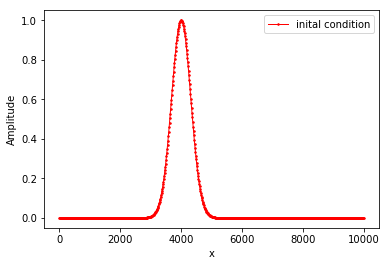

In [2]:
# Material Properties 
# -----------------------------------------------------
C   = 2500              # velcoity (m/s) 
rho = 2500              # density  (kg/m^3) 
Z   = rho*C             # impedance (kg/(s m^2))
mu  = rho*C**2          # bluk modulus 

# Model Domain 
# -----------------------------------------------------
nx  = 800               # number of grid cells
L   = 10*1000           # domain length (m)
cfl = 0.5               # Counrant Number 
T   = 20                # length of simulation (s)

# Inital Conditions
# -----------------------------------------------------
bet = 5e-6              # arugments in initial cond.
gam = 2e-5              # arugments in initial cond.
x0  = 4000              # postion of the initial conidition 

# Initalizing spatial domain 
x, dx = np.linspace(0,L,nx,retstep=True)

# CFL criterion to ensure convergence
dt  = cfl*dx/C              # calculate dt based on CFL criteron
nt  = int(np.floor(T/dt))   # nt from dt calculated

# Initalize solution matrix
Q_lwf = np.zeros((2,nx,nt)) # Lax-Wefford
Q_up  = np.zeros((2,nx,nt)) # Upwind
Q_a   = np.zeros((2,nx,nt)) # Analytical

# Inital condition
# -----------------------------------------------------
Q_lwf[0,:,0] = np.exp(-bet * (x-x0)**2) * np.cos(gam * (x - x0))
Q_up[0,:,0]  = np.exp(-bet * (x-x0)**2) * np.cos(gam * (x - x0))
Q_a[0,:,0]   = np.exp(-bet * (x-x0)**2) * np.cos(gam * (x - x0))

# Plot inital condition
# -----------------------------------------------------
plt.plot(x,  Q_lwf[0,:,0],'r-o', lw=1, markersize=1.5,  label="inital condition")
plt.ylabel('Amplitude')
plt.xlabel('x')
plt.legend()
#plt.savefig('./test.eps')

## Local Python Solutions 

We now decompose the solution into left and right propogating vectors as
$$
\begin{align*}
\Lambda^+ = \begin{bmatrix} -c & 0 \\ 0 & 0 \end{bmatrix}, && \Lambda^{-} = \begin{bmatrix} 0 & 0\\ 0 & c \end{bmatrix}, && A^{\pm} = X \Lambda^{\pm} X^{-1}
\end{align*}
$$

In [3]:
X    = np.array([[Z,-Z],[1,1]])             # Eigenvector Matrix
Xinv = 1/(2*Z) * np.array([[1,Z],[-1,Z]])   # Inverse of eigenvector Matrix
LamP = np.array([[ 0,0],[0,C]])             # Positive Lambda
LamM = np.array([[-C,0],[0,0]])             # Negative Lambda
AP   = X @ LamP @ Xinv                      # Postive decomposed A
AM   = X @ LamM @ Xinv                      # Negative decomposed A
A    = np.array([[0, -mu],[-1/rho,0]])      # Coefficent matrix A

### Upwind Method 

$$
\begin{equation}
      Q_j^{n+1} = Q_j^{n} - \frac{\Delta t}{\Delta x} \left[ A^{+} \Delta Q_l - A^{-} \Delta Q_r \right]
\end{equation}  
$$
with
$$
\begin{align*}
\Delta Q_l = Q^n_{j} - Q^n_{j-1} && \Delta Q_r = Q^n_{j+1} - Q^n_{j}
\end{align*}
$$
where 
$$
\begin{align*}
\mathcal{F}_i = A^{\pm} \Delta Q_{l,r}
\end{align*}
$$

In [4]:
# Upwind Method for 3D array 
# -----------------------------------------------------
for n in range(nt-1):
    for j in range(1,nx-1):  
        dQl = Q_up[:,j,n] - Q_up[:,j-1,n]
        dQr = Q_up[:,j+1,n] - Q_up[:,j,n]
        Q_up[:,j,n+1] = Q_up[:,j,n] - (dt/dx) * (AP.dot(dQl) + AM.dot(dQr)) 
        
    Q_up[:,0,n+1]  = Q_up[:,-2,n+1]
    Q_up[:,-1,n+1]  = Q_up[:,1,n+1]

### Lax-Wefford 

A second order numerical method

$$
\begin{equation}
      Q_j^{n+1} = Q_j^{n} - \frac{\Delta t}{2 \Delta x} A \left[\Delta Q_{j+1} - \Delta Q_{j-1} \right] + \frac{1}{2} \left( \frac{\Delta t}{\Delta x}\right)^2 A^2 \left(Q_{j+1}^n - 2Q_j^n + Q^n_{j-1}\right)
\end{equation}  
$$

In [5]:
# Lax-Wendroff scheme 
# -----------------------------------------------------
for n in range(nt-1):
    for j in range(1,nx-1):  
        dQ1 = Q_lwf[:,j+1,n] - Q_lwf[:,j-1,n]
        dQ2 =Q_lwf[:,j+1,n] - 2*Q_lwf[:,j,n] + Q_lwf[:,j-1,n]
        Q_lwf[:,j,n+1] = Q_lwf[:,j,n] - 0.5*(dt/dx) * A.dot(dQ1) +\
                     0.5*(dt/dx)**2 * (A@A).dot(dQ2)
        
    Q_lwf[:,0,n+1]   = Q_lwf[:,-2,n+1]
    Q_lwf[:,-1,n+1]  = Q_lwf[:,1,n+1]

## PyClaw

In [6]:
from clawpack import pyclaw
from clawpack import riemann

claw = pyclaw.Controller()  # initialize pyClaw Solver
claw.tfinal = T             # set intergration time equal to as defined above

pyclaw.SharpClawSolver1D(riemann.advection_1D)

claw.keep_copy = True       # Keep solution data in memory for plotting
claw.output_format = None   # Don't write solution data to file
claw.num_output_times = nt  # Write 50 output frames

riemann_solver = riemann.acoustics_1D
claw.solver = pyclaw.ClawSolver1D(riemann_solver)
claw.solver.all_bcs = pyclaw.BC.periodic
claw.solver.limiters = pyclaw.limiters.tvd.superbee

domain = pyclaw.Domain( (0.,), (L,), (nx,))
claw.solution = pyclaw.Solution(claw.solver.num_eqn,domain)

x_claw =domain.grid.x.centers
claw.solution.q[0,:] = np.exp(-bet * (x_claw-x0)**2) * np.cos(gam * (x_claw - x0))
claw.solution.q[1,:] = 0.

claw.solution.state.problem_data = {
                              'rho' : -rho,
                              'bulk': -mu,
                              'zz'  : -Z,
                              'cc'  : C
                              }
status = claw.run()

2019-12-02 15:29:56,139 INFO CLAW: Solution 0 computed for time t=0.000000
2019-12-02 15:29:56,142 INFO CLAW: Solution 1 computed for time t=0.002503
2019-12-02 15:29:56,143 INFO CLAW: Solution 2 computed for time t=0.005006
2019-12-02 15:29:56,146 INFO CLAW: Solution 3 computed for time t=0.007509
2019-12-02 15:29:56,150 INFO CLAW: Solution 4 computed for time t=0.010013
2019-12-02 15:29:56,154 INFO CLAW: Solution 5 computed for time t=0.012516
2019-12-02 15:29:56,158 INFO CLAW: Solution 6 computed for time t=0.015019
2019-12-02 15:29:56,161 INFO CLAW: Solution 7 computed for time t=0.017522
2019-12-02 15:29:56,164 INFO CLAW: Solution 8 computed for time t=0.020025
2019-12-02 15:29:56,167 INFO CLAW: Solution 9 computed for time t=0.022528
2019-12-02 15:29:56,169 INFO CLAW: Solution 10 computed for time t=0.025031
2019-12-02 15:29:56,171 INFO CLAW: Solution 11 computed for time t=0.027534
2019-12-02 15:29:56,174 INFO CLAW: Solution 12 computed for time t=0.030038
2019-12-02 15:29:56,17

Exception ignored in: <bound method SharpClawSolver.__del__ of <clawpack.pyclaw.sharpclaw.solver.SharpClawSolver1D object at 0x12ab5cdd8>>
Traceback (most recent call last):
  File "/Users/andrewnolan/bin/clawpack_src/clawpack-v5.6.1/pyclaw/src/pyclaw/sharpclaw/solver.py", line 276, in __del__
    self.fmod.clawparams.dealloc_clawparams()
AttributeError: 'NoneType' object has no attribute 'clawparams'


2019-12-02 15:29:56,333 INFO CLAW: Solution 90 computed for time t=0.225282
2019-12-02 15:29:56,335 INFO CLAW: Solution 91 computed for time t=0.227785
2019-12-02 15:29:56,338 INFO CLAW: Solution 92 computed for time t=0.230288
2019-12-02 15:29:56,341 INFO CLAW: Solution 93 computed for time t=0.232791
2019-12-02 15:29:56,343 INFO CLAW: Solution 94 computed for time t=0.235294
2019-12-02 15:29:56,345 INFO CLAW: Solution 95 computed for time t=0.237797
2019-12-02 15:29:56,347 INFO CLAW: Solution 96 computed for time t=0.240300
2019-12-02 15:29:56,349 INFO CLAW: Solution 97 computed for time t=0.242804
2019-12-02 15:29:56,351 INFO CLAW: Solution 98 computed for time t=0.245307
2019-12-02 15:29:56,353 INFO CLAW: Solution 99 computed for time t=0.247810
2019-12-02 15:29:56,356 INFO CLAW: Solution 100 computed for time t=0.250313
2019-12-02 15:29:56,357 INFO CLAW: Solution 101 computed for time t=0.252816
2019-12-02 15:29:56,359 INFO CLAW: Solution 102 computed for time t=0.255319
2019-12-0

## Analytical Solution 
$$
\begin{equation}
\begin{gathered}
    \sigma(x,t) = \frac{1}{2} (\sigma^0(x+Ct) + \sigma^0(x-Ct)) + \frac{Z}{2} (v^0(x+Ct) - v^0(x-Ct)) \\ 
    v(x,t) = \frac{1}{2Z}(\sigma^0(x+Ct) - \sigma^0(x-Ct)) + \frac{1}{2}(v^0(x+Ct) + v^0(x-Ct)).
    \label{eq:analsolution}
\end{gathered}
\end{equation}
$$


$$
\begin{equation}
    \sigma(x,0) = e^{-\beta (x-x_0)^2} \cos (\gamma (x-x_0))
\end{equation}
$$

In [8]:
for n in range(nt):
    Q_a[0,:,n] = (1./2.)*(np.exp(-bet * (x[:]-x0 + C*n*dt)**2)*np.cos(gam*(x[:]-x0 + C*n*dt))\
        + np.exp(-bet * (x[:]-x0 - C*n*dt)**2)*np.cos(gam*(x[:]-x0 - C*n*dt)))
    
    Q_a[1,:,n] = (1./(2*Z))*(np.exp(-bet * (x[:]-x0 + C*n*dt)**2)*np.cos(gam*(x[:]-x0 + C*n*dt))\
        - np.exp(-bet * (x[:]-x0 - C*n*dt)**2)*np.cos(gam*(x[:]-x0 - C*n*dt)))
    

# Intercomparision of method

In [9]:
fig, ax = plt.subplots(2,1,figsize=(15,8))

ax[0].set_xlim(0, L)
ax[0].set_ylim(-0.8, 1.2)

ax[1].set_xlim(0, L)
ax[1].set_ylim(-0.9e-7, 1.2e-7)

ax[0].set_ylabel('Stress')
ax[1].set_ylabel('Velocity')
ax[1].set_xlabel(' x ')

line1, = ax[0].plot([], [], lw=2, color='lightblue',label='Upwind')
line2, = ax[1].plot([], [], lw=2, color='lightblue')
line3, = ax[0].plot([], [], lw=2, color='k',ls=':',label='Lax-Wefford')
line4, = ax[1].plot([], [], lw=2, color='k',ls=':')
line5, = ax[0].plot([], [], lw=2, color='r',ls='--',label='PyClaw')
line6, = ax[1].plot([], [], lw=2, color='r',ls='--')

line = [line1, line2,line3,line4,line5,line6]
ax[0].legend(loc=3)

def animate(i):  
    global x,Q_lwf,Q_up,Q_a
    
    frame = claw.frames[i]
    pressure = frame.q[0,:]
    velocity = frame.q[1,:]
    
    line[0].set_data(x, Q_up[0,:,i])
    line[1].set_data(x, Q_up[1,:,i])
    line[2].set_data(x, Q_lwf[0,:,i])
    line[3].set_data(x, Q_lwf[1,:,i])
    line[4].set_data(x_claw,pressure)
    line[5].set_data(x_claw,velocity)
    return line

anim = animation.FuncAnimation(fig, animate, 
                               frames=range(0,nt,10), interval=40, blit=True)
plt.close()
anim

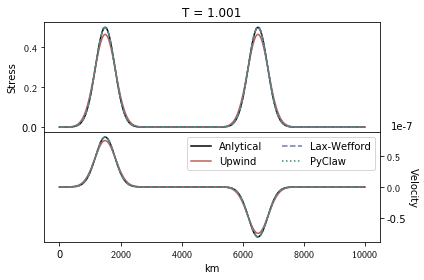

In [10]:
fig, ax = plt.subplots(2,1,sharex=True)

ax[0].set_ylabel("Stress")
ax[1].set_ylabel("Velocity",labelpad = 11, rotation=270)
ax[1].yaxis.tick_right()
ax[1].yaxis.set_label_position("right")
ax[1].get_yaxis().get_offset_text().set_x(1.1)

ax[1].set_xlabel("km")
ax[0].set_title('T = {:.3f}'.format(400*dt))
#BF5E58,#707BA7,#278F69,#A6782D


ax[0].plot(x, Q_a[0,:,400],c = 'k')
ax[1].plot(x, Q_a[1,:,400],c = 'k',label='Anlytical')

ax[0].plot(x, Q_up[0,:,400],c = '#BF5E58')
ax[1].plot(x, Q_up[1,:,400],c = '#BF5E58', label='Upwind')

ax[0].plot(x, Q_lwf[0,:,400],c = '#707BA7',ls='--')
ax[1].plot(x, Q_lwf[1,:,400],c = '#707BA7',ls='--',label='Lax-Wefford')


ax[0].plot(x, claw.frames[400].q[0,:],c = '#278F69',ls=':')
ax[1].plot(x, claw.frames[400].q[1,:],c = '#278F69',ls=':',label='PyClaw')



ax[1].legend(ncol=2)

plt.rcParams['text.usetex'] = True
plt.tight_layout()
plt.subplots_adjust(hspace=0)
plt.savefig('../figures/four_methods.eps')

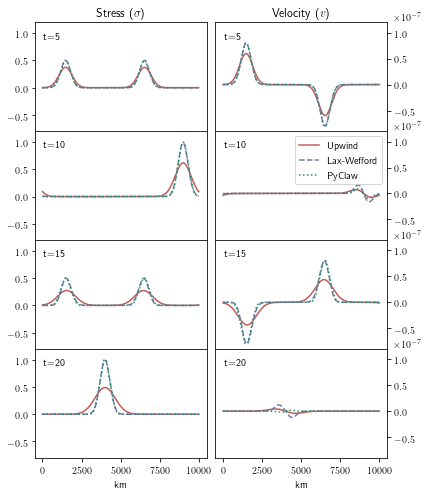

In [11]:
fig, ax = plt.subplots(4,2,sharex=True,sharey='col',figsize=(6,7))

#ax[0].set_ylabel("Stress")
#ax[1].set_ylabel("Velocity",labelpad = 11, rotation=270)
ax[0,1].yaxis.tick_right()
ax[1,1].yaxis.tick_right()
ax[2,1].yaxis.tick_right()
ax[3,1].yaxis.tick_right()
#ax[1].yaxis.set_label_position("right")


ax[0,0].set_ylim(-0.8, 1.2)

ax[0,1].set_ylim(-0.9e-7, 1.2e-7)

# t = 5
# -----------------------------------------------------
ax[0,0].plot(x, Q_up[0,:,2000],c = '#BF5E58')
ax[0,1].plot(x, Q_up[1,:,2000],c = '#BF5E58', label='Upwind')

ax[0,0].plot(x, Q_lwf[0,:,2000],c = '#707BA7',ls='--')
ax[0,1].plot(x, Q_lwf[1,:,2000],c = '#707BA7',ls='--',label='Lax-Wefford')

ax[0,0].plot(x, claw.frames[2000].q[0,:],c = '#278F69',ls=':')
ax[0,1].plot(x, claw.frames[2000].q[1,:],c = '#278F69',ls=':',label='PyClaw')

ax[0,0].text(0.05, 0.85,'t=5',size=10,transform=ax[0,0].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))
ax[0,1].text(0.05, 0.85,'t=5',size=10,transform=ax[0,1].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))

# t = 10
# -----------------------------------------------------

ax[1,0].plot(x, Q_up[0,:,4000],c = '#BF5E58')
ax[1,1].plot(x, Q_up[1,:,4000],c = '#BF5E58', label='Upwind')

ax[1,0].plot(x, Q_lwf[0,:,4000],c = '#707BA7',ls='--')
ax[1,1].plot(x, Q_lwf[1,:,4000],c = '#707BA7',ls='--',label='Lax-Wefford')

ax[1,0].plot(x, claw.frames[4000].q[0,:],c = '#278F69',ls=':')
ax[1,1].plot(x, claw.frames[4000].q[1,:],c = '#278F69',ls=':',label='PyClaw')

ax[1,0].text(0.05, 0.85,'t=10',size=10,transform=ax[1,0].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))
ax[1,1].text(0.05, 0.85,'t=10',size=10,transform=ax[1,1].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))

# t = 15
# -----------------------------------------------------

ax[2,0].plot(x, Q_up[0,:,5991],c = '#BF5E58')
ax[2,1].plot(x, Q_up[1,:,5991],c = '#BF5E58', label='Upwind')

ax[2,0].plot(x, Q_lwf[0,:,5991],c = '#707BA7',ls='--')
ax[2,1].plot(x, Q_lwf[1,:,5991],c = '#707BA7',ls='--',label='Lax-Wefford')

ax[2,0].plot(x, claw.frames[5991].q[0,:],c = '#278F69',ls=':')
ax[2,1].plot(x, claw.frames[5991].q[1,:],c = '#278F69',ls=':',label='PyClaw')

ax[2,0].text(0.05, 0.85,'t=15',size=10,transform=ax[2,0].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))
ax[2,1].text(0.05, 0.85,'t=15',size=10,transform=ax[2,1].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))


# t = 20
# -----------------------------------------------------

ax[3,0].plot(x, Q_up[0,:,7989],c = '#BF5E58')
ax[3,1].plot(x, Q_up[1,:,7989],c = '#BF5E58', label='Upwind')

ax[3,0].plot(x, Q_lwf[0,:,7989],c = '#707BA7',ls='--')
ax[3,1].plot(x, Q_lwf[1,:,7989],c = '#707BA7',ls='--',label='Lax-Wefford')

ax[3,0].plot(x, claw.frames[7989].q[0,:],c = '#278F69',ls=':')
ax[3,1].plot(x, claw.frames[7989].q[1,:],c = '#278F69',ls=':',label='PyClaw')

ax[3,0].text(0.05, 0.85,'t=20',size=10,transform=ax[3,0].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))
ax[3,1].text(0.05, 0.85,'t=20',size=10,transform=ax[3,1].transAxes,bbox=dict(facecolor='white', alpha=0, edgecolor = 'none'))

# ax[0].set_ylabel("Stress")
# ax[1].set_ylabel("Velocity",labelpad = 11, rotation=270)
# ax[1].yaxis.tick_right()

# ax[1].yaxis.set_label_position("right")

ax[0,1].get_yaxis().get_offset_text().set_x(1.2)
ax[1,1].get_yaxis().get_offset_text().set_x(1.2)
ax[2,1].get_yaxis().get_offset_text().set_x(1.2)
ax[3,1].get_yaxis().get_offset_text().set_x(1.2)


ax[3,0].set_xlabel("km")
ax[3,1].set_xlabel("km")

ax[0,0].set_title('Stress ($\sigma$)')
ax[0,1].set_title('Velocity ($v$)')

ax[1,1].legend() 

plt.tight_layout()
plt.subplots_adjust(hspace=0,wspace=0.05)

plt.savefig('../figures/longrun.eps')